<a href="https://colab.research.google.com/github/mutkarsh06/Assignment-1/blob/main/combine.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

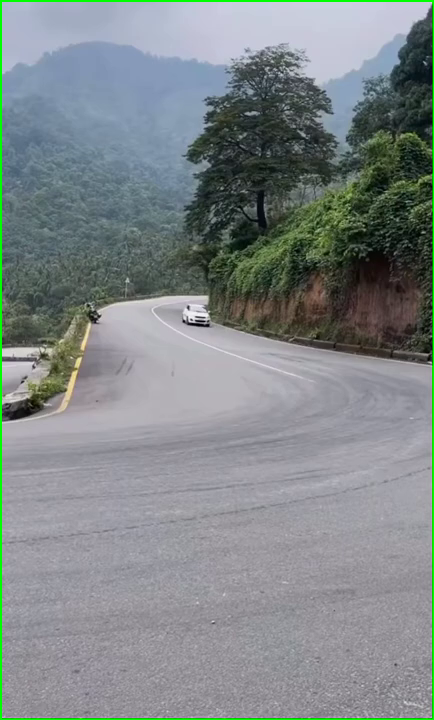

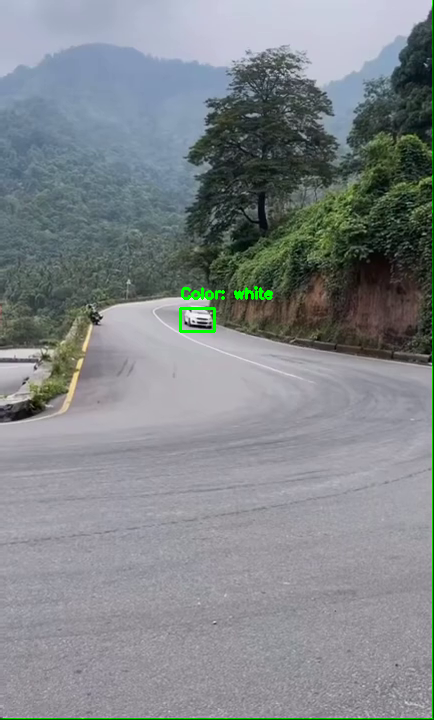

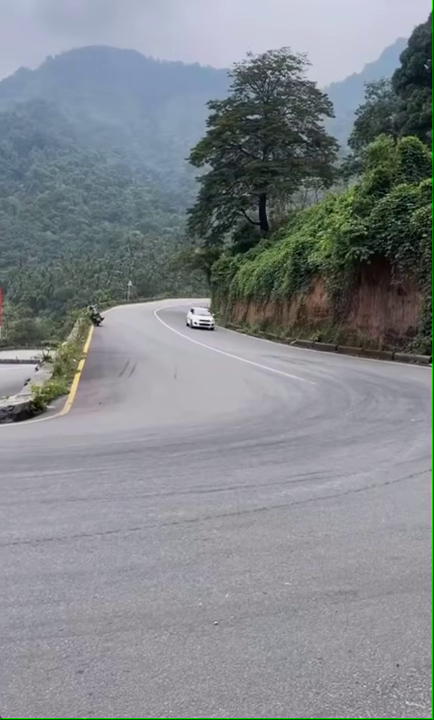

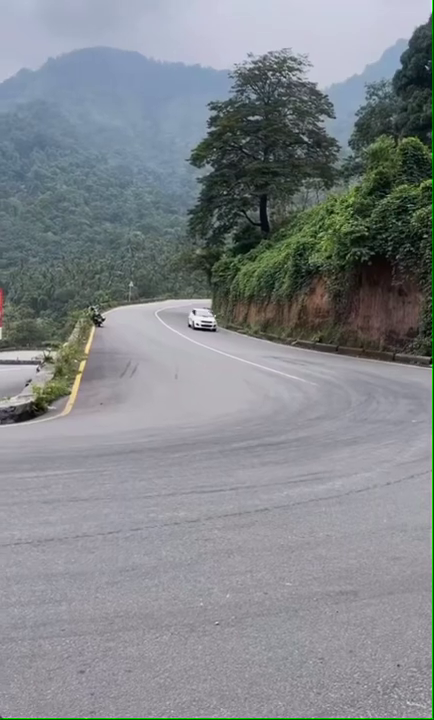

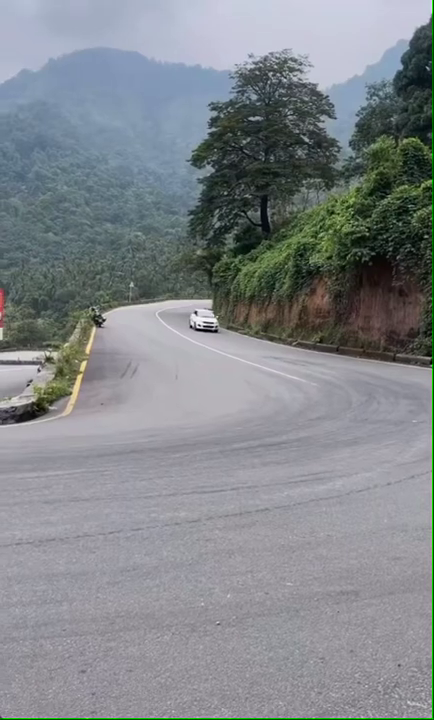

...

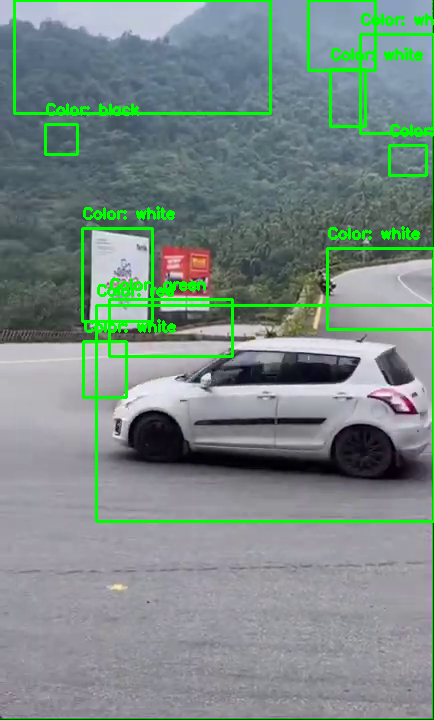

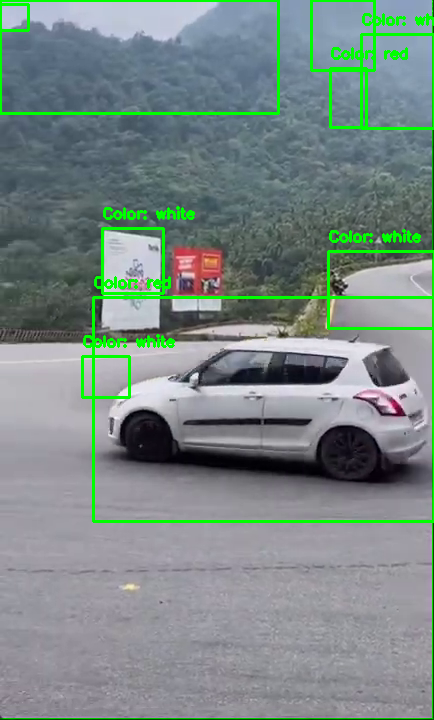

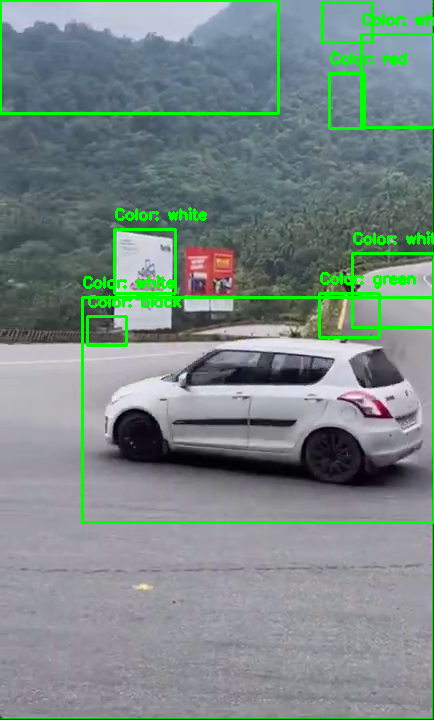

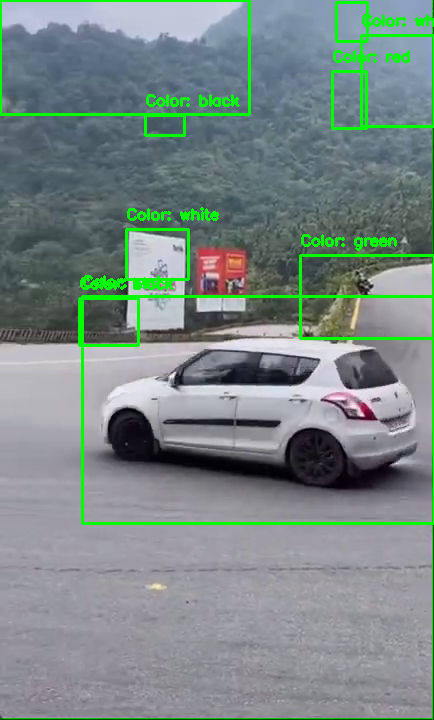

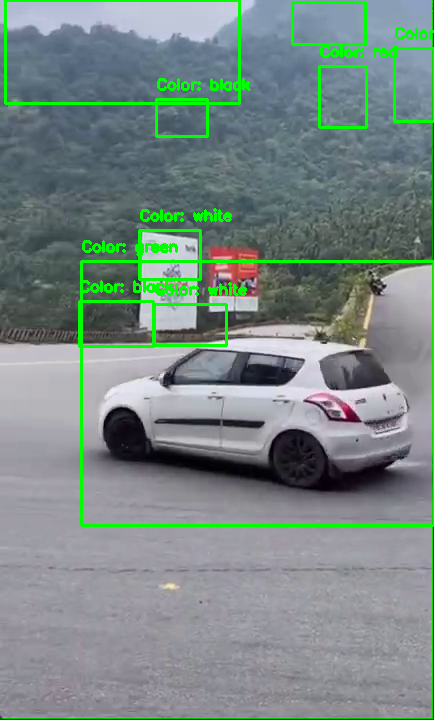

Buffered data was truncated after reaching the output size limit.

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
from sklearn.neighbors import KNeighborsClassifier


cap = cv2.VideoCapture('/content/drive/MyDrive/Projectmini/yt.mp4')

if not cap.isOpened():
    print("Error: Could not open video file.")
    exit()

background_subtractor = cv2.createBackgroundSubtractorMOG2()

color_classifier = KNeighborsClassifier(n_neighbors=1)


colors = ['red', 'green', 'blue', 'white', 'black']
color_values = [[255, 0, 0], [0, 255, 0], [0, 0, 255], [255, 255, 255], [0, 0, 0]]

color_classifier.fit(color_values, colors)

output_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
output_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
output_fps = cap.get(cv2.CAP_PROP_FPS)
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter('/content/drive/MyDrive/Projectmini/Modelcheck_output.avi', fourcc, output_fps, (output_width, output_height))

previous_frame = None
vehicle_count = 0
speeds = []

while(cap.isOpened()):
    ret, frame = cap.read()
    if not ret:
        break

    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    fg_mask = background_subtractor.apply(gray_frame)

    fg_mask = cv2.morphologyEx(fg_mask, cv2.MORPH_OPEN, cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5)))
    fg_mask = cv2.dilate(fg_mask, None, iterations=2)

    contours, _ = cv2.findContours(fg_mask.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    for contour in contours:
        if cv2.contourArea(contour) < 500:
            continue

        x, y, w, h = cv2.boundingRect(contour)

        vehicle_image = frame[y:y+h, x:x+w]

        vehicle_image = cv2.resize(vehicle_image, (100, 100))

        mean_color = np.mean(vehicle_image, axis=(0, 1))
        color_name = color_classifier.predict([mean_color])[0]

        if previous_frame is not None:
            vehicle_count += 1

        cv2.rectangle(frame, (x, y), (x+w, y+h), (0, 255, 0), 2)
        cv2.putText(frame, f'Color: {color_name}', (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    speeds.append(vehicle_count)
    vehicle_count = 0

    out.write(frame)

    cv2_imshow(frame)

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

    previous_frame = gray_frame

if speeds:
    average_speed = np.mean(speeds)
    print(f'Average speed of vehicles: {average_speed} km/hr')
else:
    print('No vehicles detected in the video.')

cap.release()
out.release()
cv2.destroyAllWindows()
